In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
### Initial imports
import logging
import numpy as np
import pandas as pd
import pymc3 as pm
import theano.tensor as T
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("ticks")

logging.basicConfig(level=logging.INFO)
log = logging.getLogger(__name__)

import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

from epimodel.pymc3_models import cm_effect
from epimodel.pymc3_models.cm_effect.datapreprocessor import DataPreprocessor

%matplotlib inline

INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Smoothing
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Albania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Andorra
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Estonia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Iceland
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Latvia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Lithuania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing New Zealand
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Singapore
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Slovakia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Masking


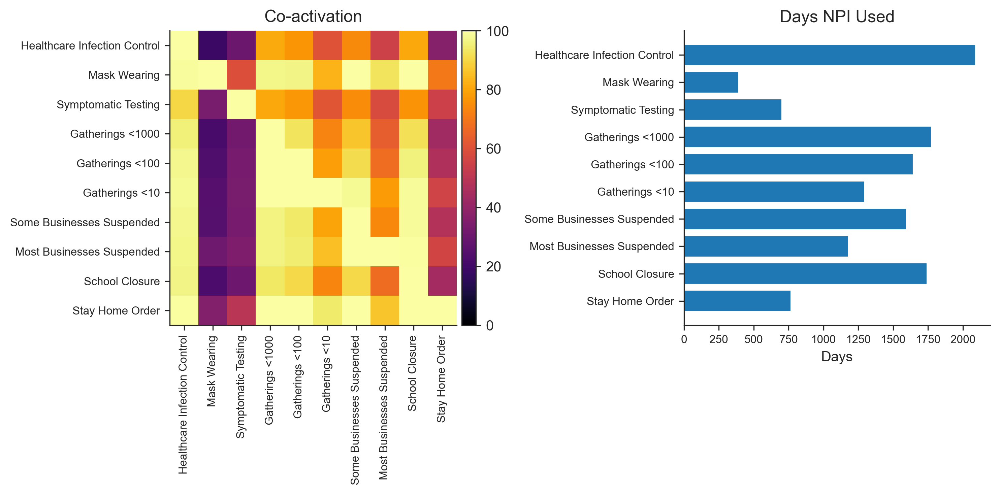

In [5]:
dp = DataPreprocessor()
data = dp.preprocess_data("data_final.csv")

In [6]:
# data.filter_region_min_deaths(100)

In [8]:
def mask_region_ends(d, region, ndays=10):
    i = d.Rs.index(region)
    d.Active.mask[i,-ndays:] = True
    d.Confirmed.mask[i,-ndays:] = True
    d.Deaths.mask[i,-ndays:] = True
    d.NewDeaths.mask[i,-ndays:] = True
    d.NewCases.mask[i,-ndays:] = True

for region in data.Rs:
    mask_region_ends(data, region, 7)

mask_region_ends(data, "ES", 40)
mask_region_ends(data, "FR", 40)

In [9]:
with cm_effect.models.CMActive_Final(data) as model:
    model.build_model()

Skipped day [(22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (1, 2), (2, 2), (3, 2), (4, 2), (5, 2), (6, 2), (7, 2), (8, 2), (9, 2), (10, 2), (11, 2), (12, 2), (13, 2), (14, 2), (15, 2), (16, 2), (17, 2), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (23, 2), (24, 2), (25, 2), (26, 2), (27, 2), (28, 2), (29, 2), (1, 3), (2, 3), (3, 3), (4, 3), (5, 3), (6, 3), (7, 3), (8, 3), (9, 3), (10, 3), (11, 3), (12, 3), (13, 3), (14, 3), (15, 3), (16, 3), (17, 3), (18, 3), (19, 3), (20, 3), (21, 3), (22, 3), (19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AL
Skipped day [(22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (1, 2), (2, 2), (3, 2), (4, 2), (5, 2), (6, 2), (7, 2), (8, 2), (9, 2), (10, 2), (11, 2), (12, 2), (13, 2), (14, 2), (15, 2), (16, 2), (17, 2), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (23, 2), (24, 2), (25, 2), (26, 2), (27, 2), (28, 2), (29, 2), (1, 3), (2, 3), (3, 3), (4, 3),

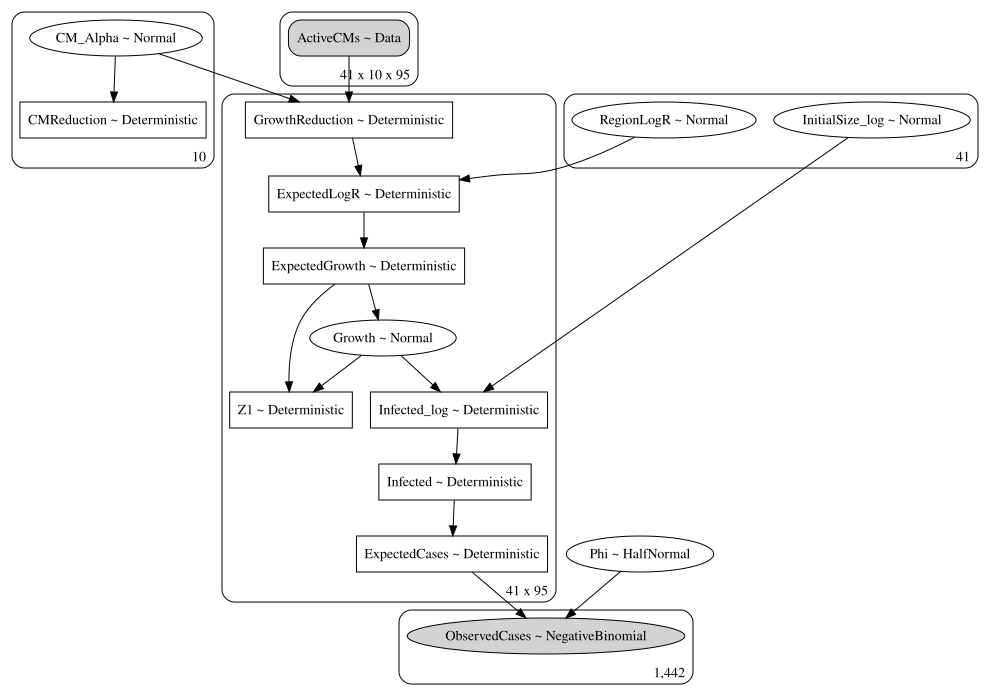

In [10]:
pm.model_to_graphviz(model).render("model-active-final")
pm.model_to_graphviz(model)

In [ ]:
with model.model:
    model.trace = pm.sample(2000, chains=2, target_accept=0.95)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
INFO:pymc3:NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
Sampling 2 chains, 0 divergences:  76%|███████▋  | 3813/5000 [40:32<13:07,  1.51draws/s]

In [ ]:
cm_plot_style = [
            ("\uf7f2", "tab:red"), # hospital symbol
            ("\uf963", "black"), # mask
            ("\uf492", "mediumblue"), # vial
            ("\uf0c0", "lightgrey"), # ppl
            ("\uf0c0", "grey"), # ppl
            ("\uf0c0", "black"), # ppl
            ("\uf07a", "tab:orange"), # shop 1
            ("\uf07a", "tab:red"), # shop2 
            ("\uf19d", "black"), # school
            ("\uf965", "black") # home
        ]

model.plot_region_predictions(cm_plot_style)

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out


<Figure size 2100x900 with 0 Axes>

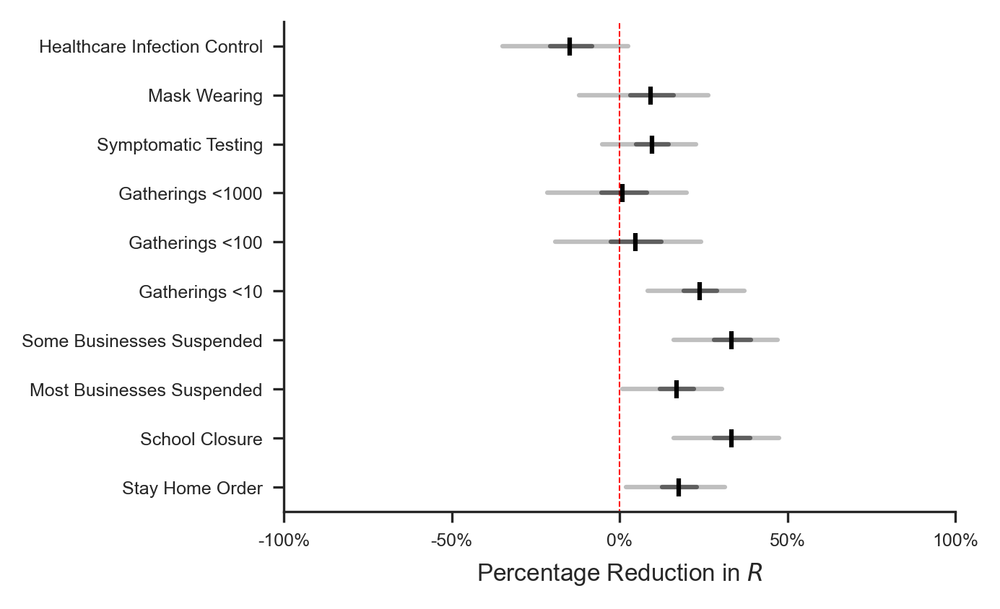

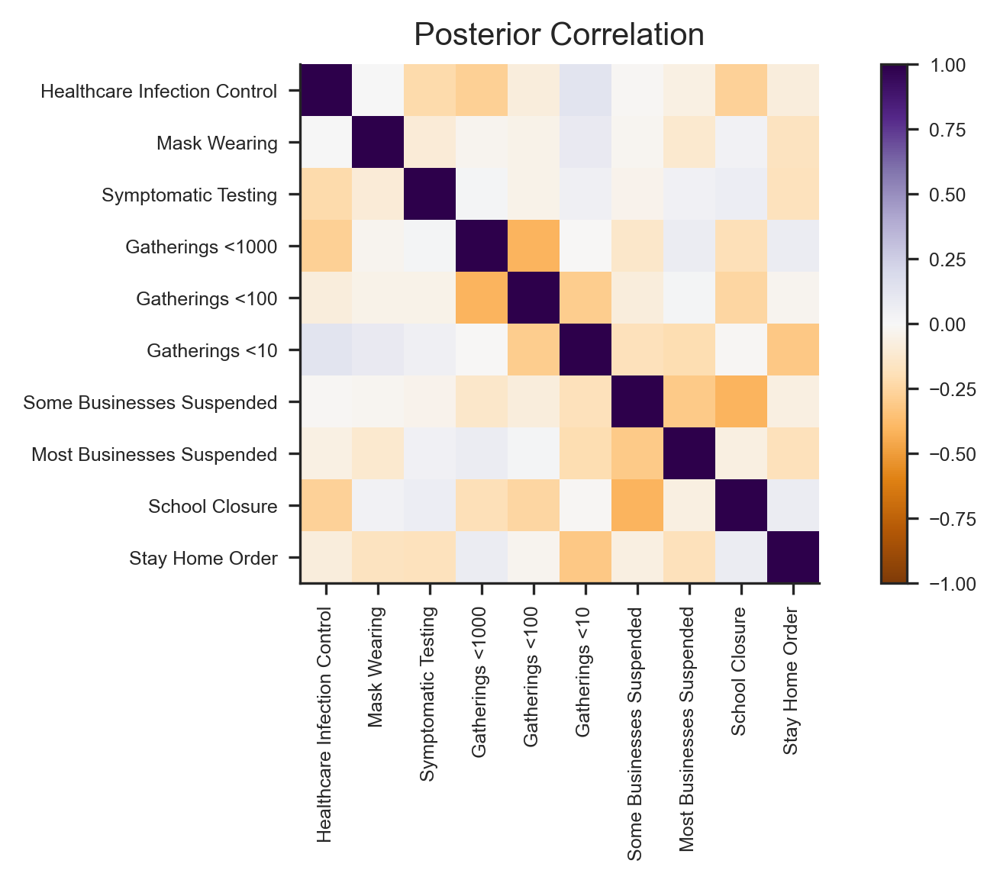

In [17]:
model.plot_effect()

In [36]:
for i, cm in enumerate(model.d.CMs):
    print(f"CM: {cm} mean: {np.mean(model.trace['CMReduction'][:, i]):.3f} [{np.percentile(model.trace['CMReduction'][:, i], 2.5):.3f}, {np.percentile(model.trace['CMReduction'][:, i], 97.5):.3f}]")

CM: Healthcare Infection Control mean: 1.147 [0.973, 1.349]
CM: Mask Wearing mean: 0.908 [0.735, 1.122]
CM: Symptomatic Testing mean: 0.904 [0.772, 1.052]
CM: Gatherings <1000 mean: 0.991 [0.800, 1.214]
CM: Gatherings <100 mean: 0.954 [0.758, 1.191]
CM: Gatherings <10 mean: 0.761 [0.627, 0.916]
CM: Some Businesses Suspended mean: 0.666 [0.528, 0.838]
CM: Most Businesses Suspended mean: 0.831 [0.694, 0.991]
CM: School Closure mean: 0.667 [0.524, 0.839]
CM: Stay Home Order mean: 0.824 [0.685, 0.980]


In [22]:
np.mean(model.trace["CMReduction"][:, 0])

1.1474681853633302

In [50]:
with cm_effect.models.CMActive_Final_NB(data) as model2:
    model2.build_model()

Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AL
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AD
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AT
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for BE
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for BA
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for BG
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for HR
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for CZ
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for DK
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for EE
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for FI
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for FR
Skip

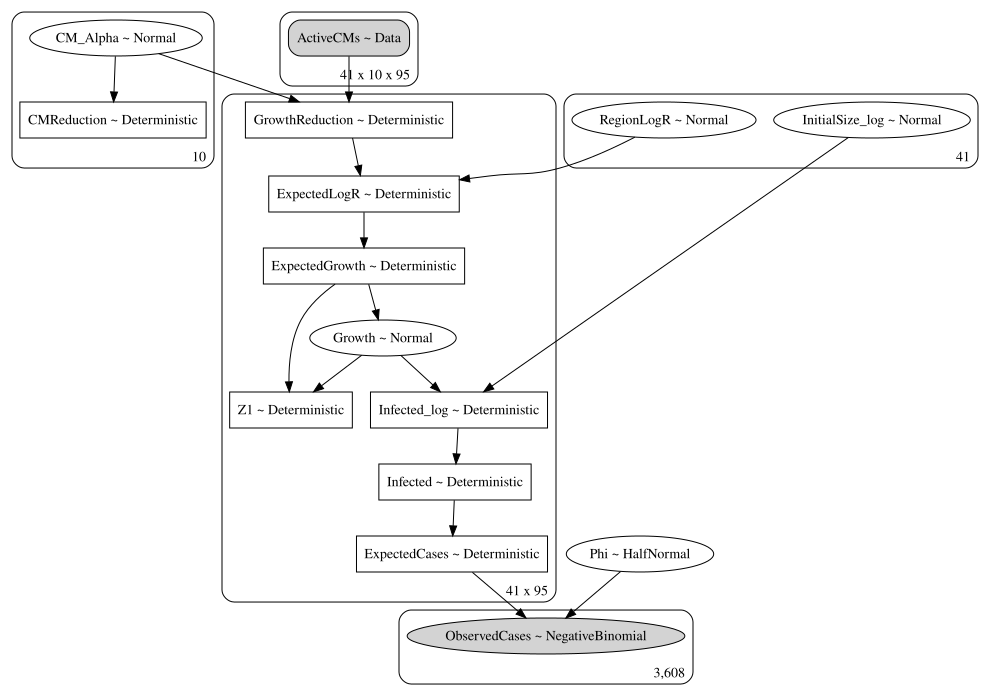

In [52]:
pm.model_to_graphviz(model2).render("model-active-final-alt")
pm.model_to_graphviz(model2)

In [54]:
with model2.model:
    model2.trace = pm.sample(2000, chains=2)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
INFO:pymc3:NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [34:02<00:00,  2.45draws/s]


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out


<Figure size 2100x900 with 0 Axes>

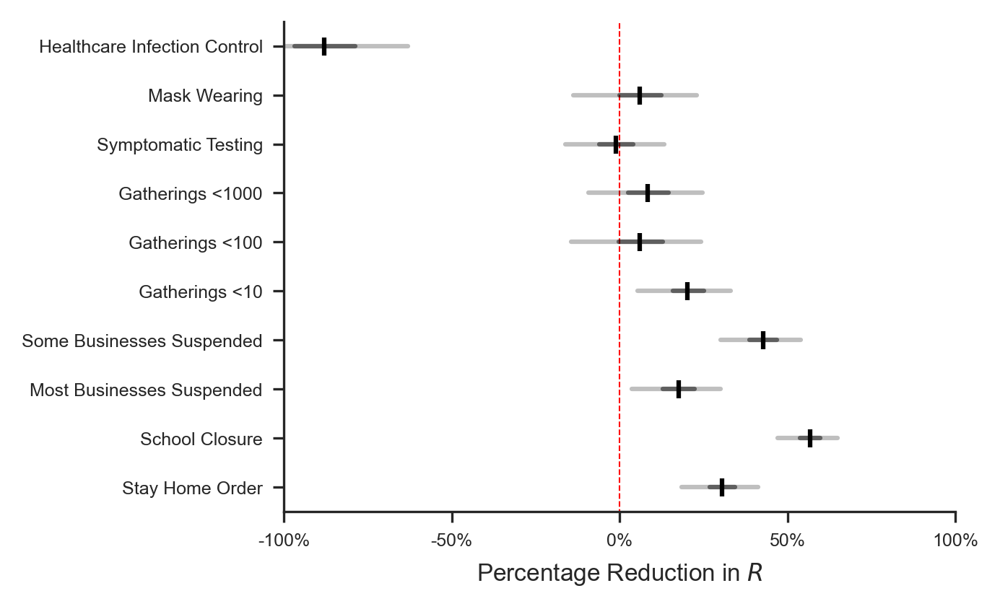

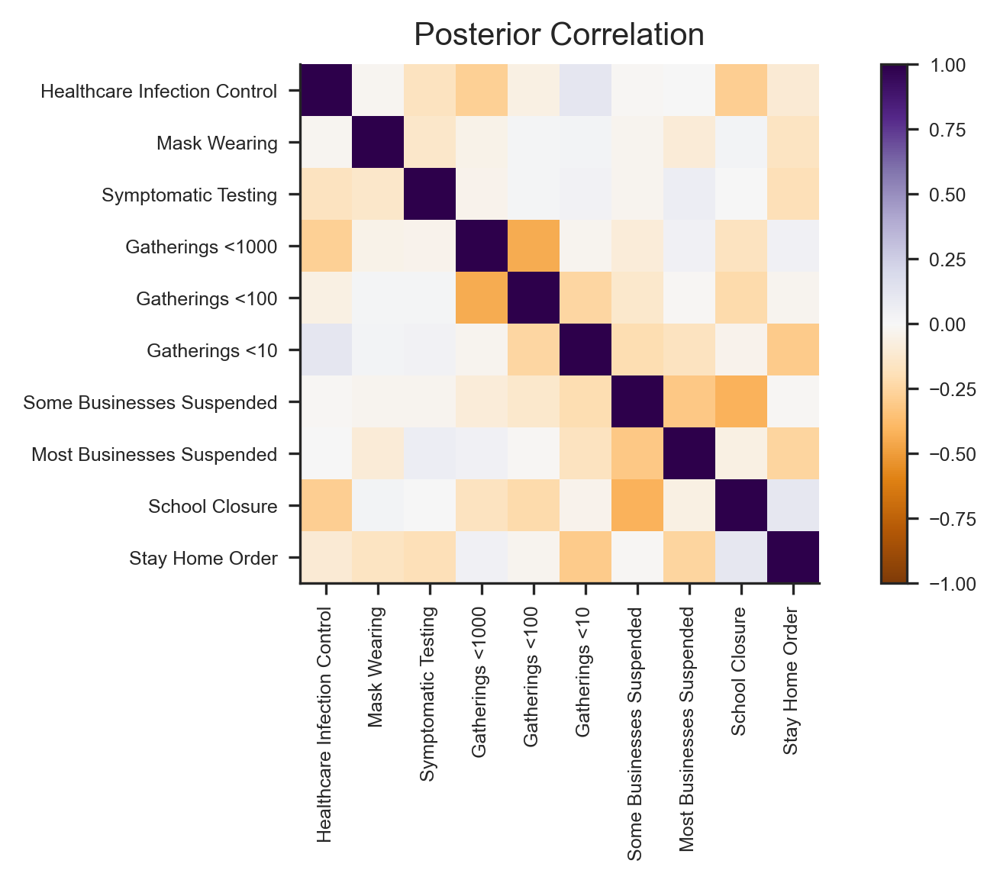

In [59]:
model2.plot_effect()

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effe

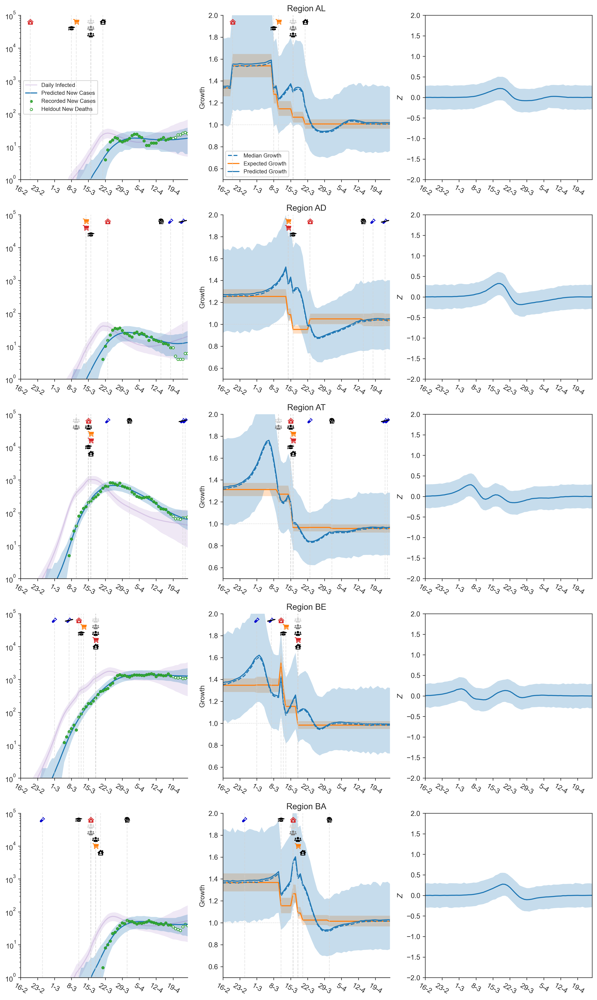

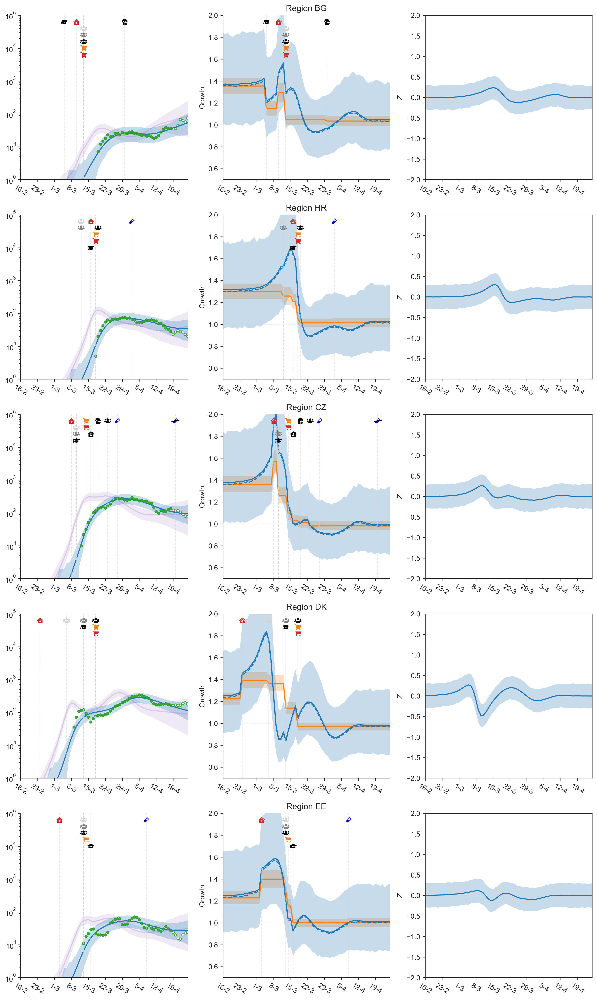

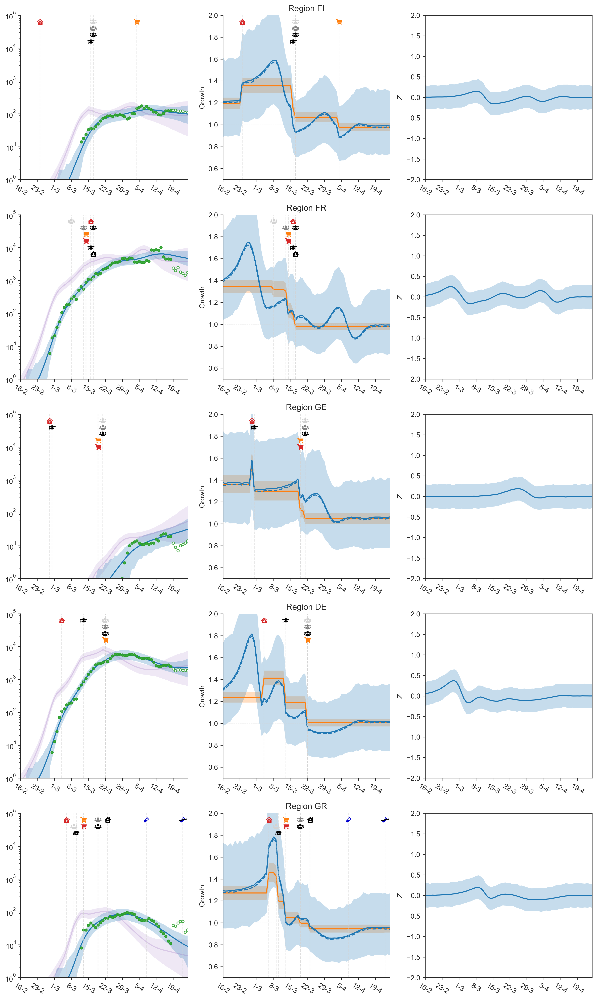

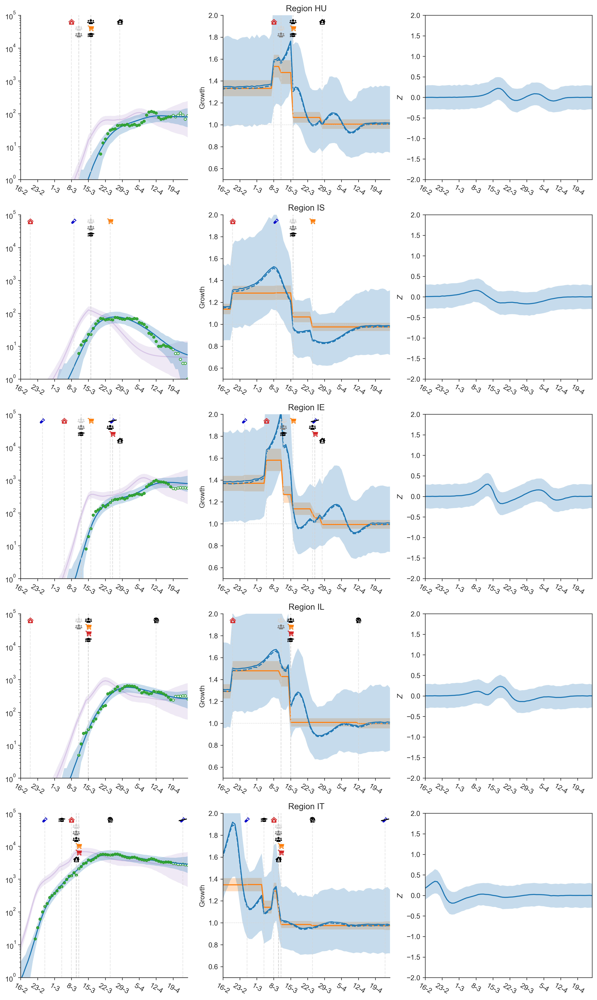

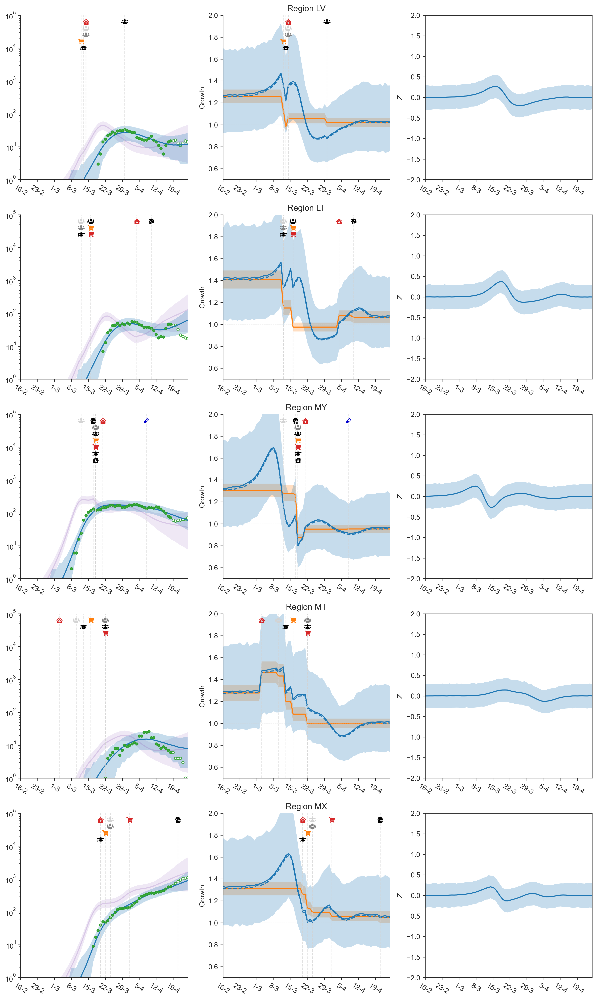

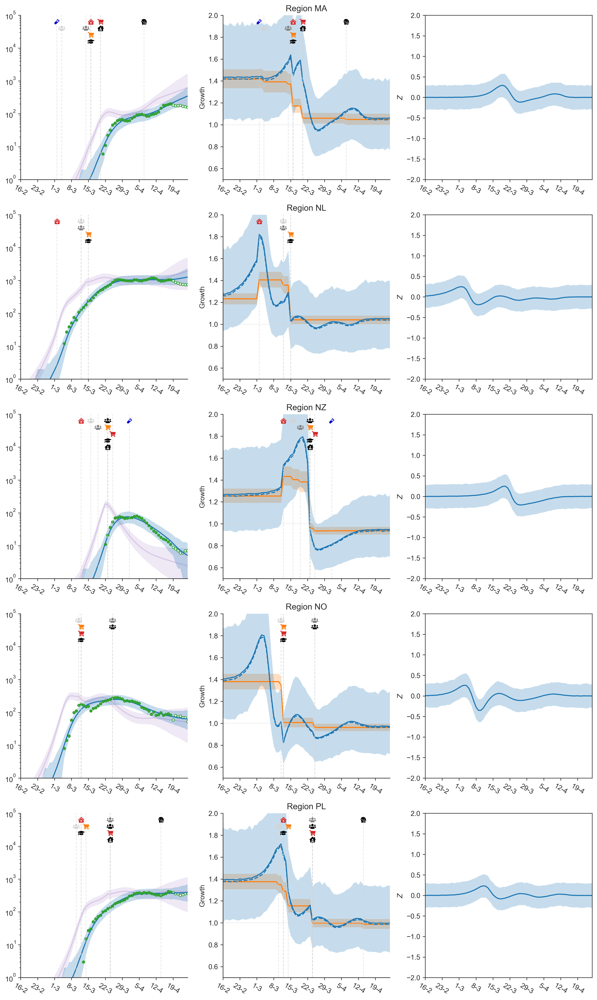

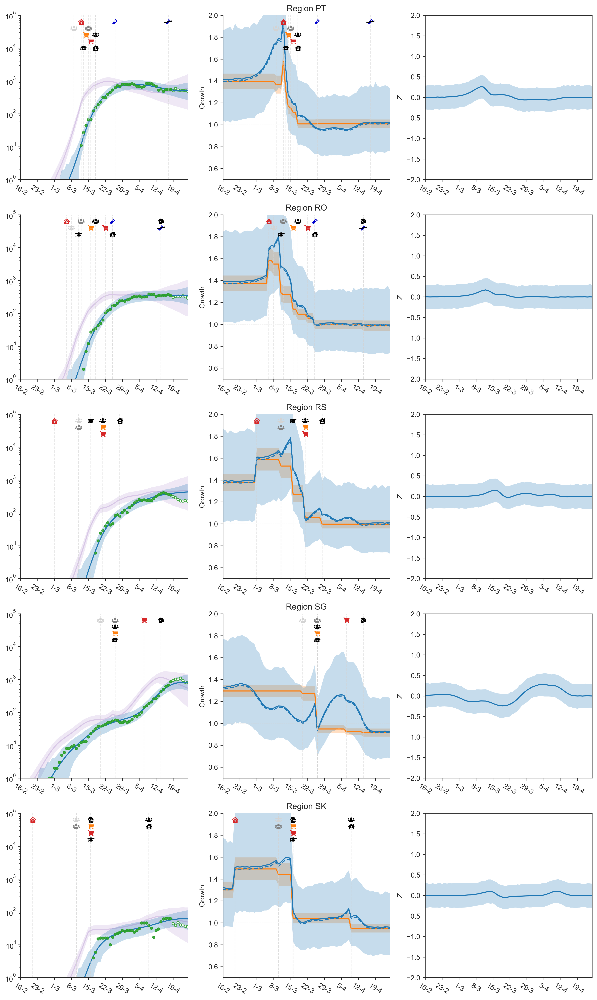

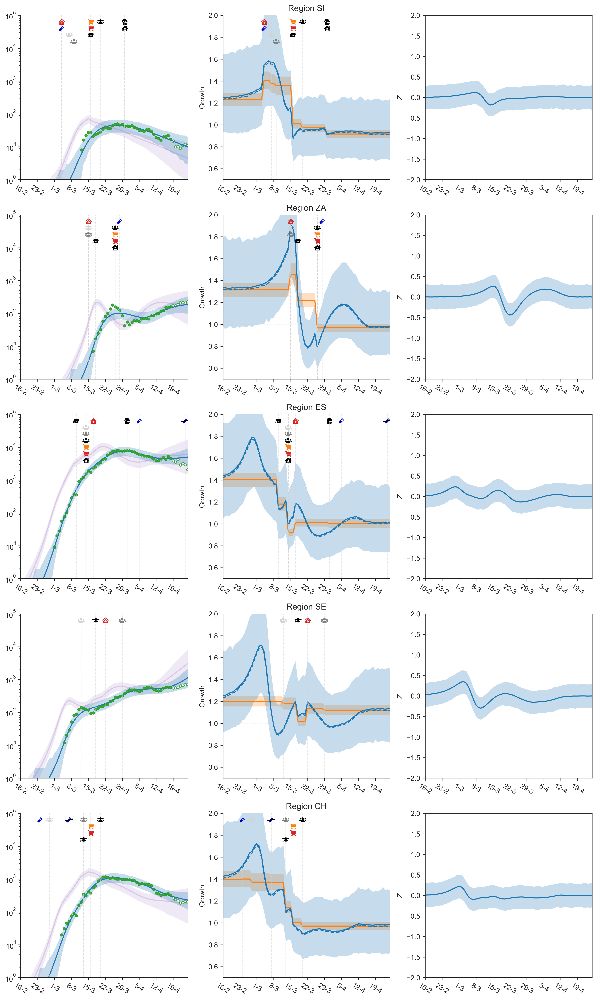

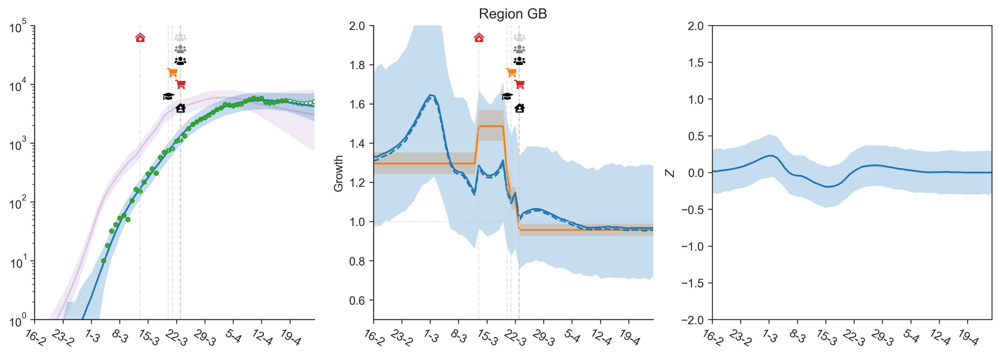

In [60]:
model2.plot_region_predictions(cm_plot_style)

In [63]:
model2.trace["CMReduction"][:, 0]

array([1.87185452, 1.67212667, 2.03735748, ..., 1.84734548, 1.87089452,
       1.90813453])

In [64]:
np.mean(model2.trace["CMReduction"][:, 0])

1.879068268880203

In [66]:
with cm_effect.models.CMActive_Final_NB(data) as model3:
    model3.build_model()

Skipped day [(22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (1, 2), (2, 2), (3, 2), (4, 2), (5, 2), (6, 2), (7, 2), (8, 2), (9, 2), (10, 2), (11, 2), (12, 2), (13, 2), (14, 2), (15, 2), (16, 2), (17, 2), (18, 2), (19, 2), (20, 2), (21, 2), (19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AL
Skipped day [(22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (1, 2), (2, 2), (3, 2), (4, 2), (5, 2), (6, 2), (7, 2), (8, 2), (9, 2), (10, 2), (11, 2), (12, 2), (13, 2), (14, 2), (15, 2), (16, 2), (17, 2), (18, 2), (19, 2), (20, 2), (21, 2), (19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AD
Skipped day [(22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (1, 2), (2, 2), (3, 2), (4, 2), (5, 2), (6, 2), (7, 2), (8, 2), (9, 2), (10, 2), (11, 2), (12, 2), (13, 2), (14, 2), (15, 2), (16, 2), (17, 2), (18, 2), (19, 2), (20, 2), (21, 2), (19, 4), (2

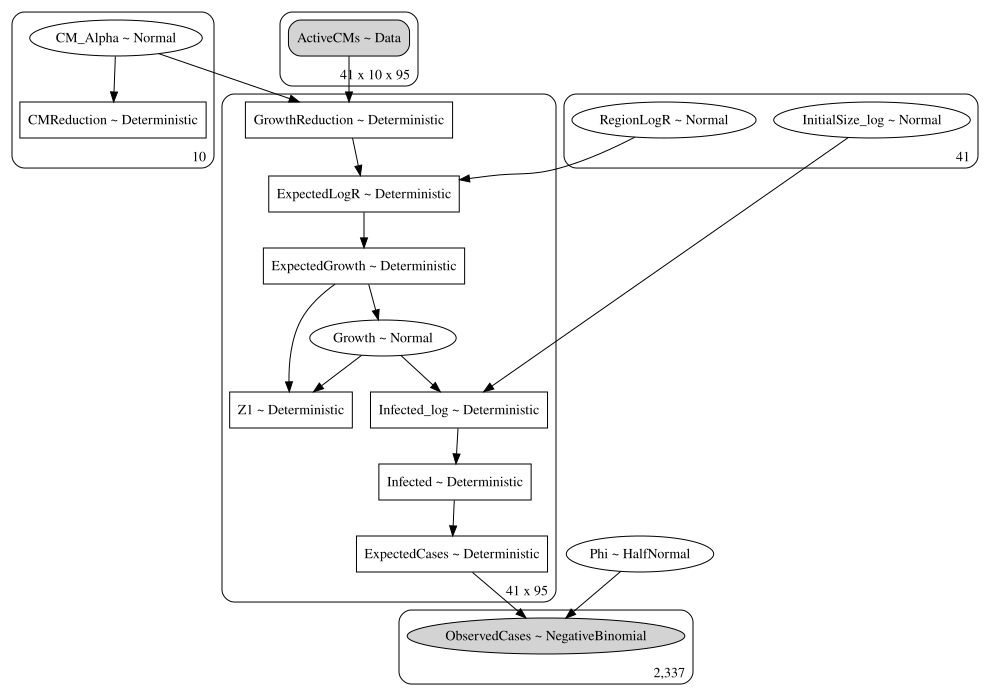

In [67]:
pm.model_to_graphviz(model3).render("model-active-final")
pm.model_to_graphviz(model3)

In [68]:
with model3.model:
    model3.trace = pm.sample(2000, chains=2)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
INFO:pymc3:NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [29:48<00:00,  2.80draws/s] 


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out


<Figure size 2100x900 with 0 Axes>

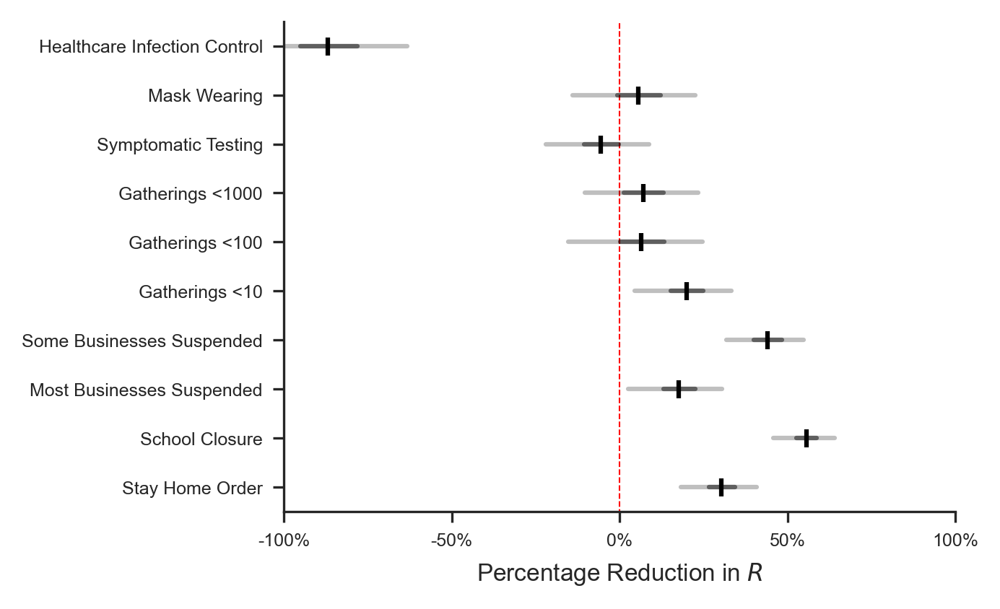

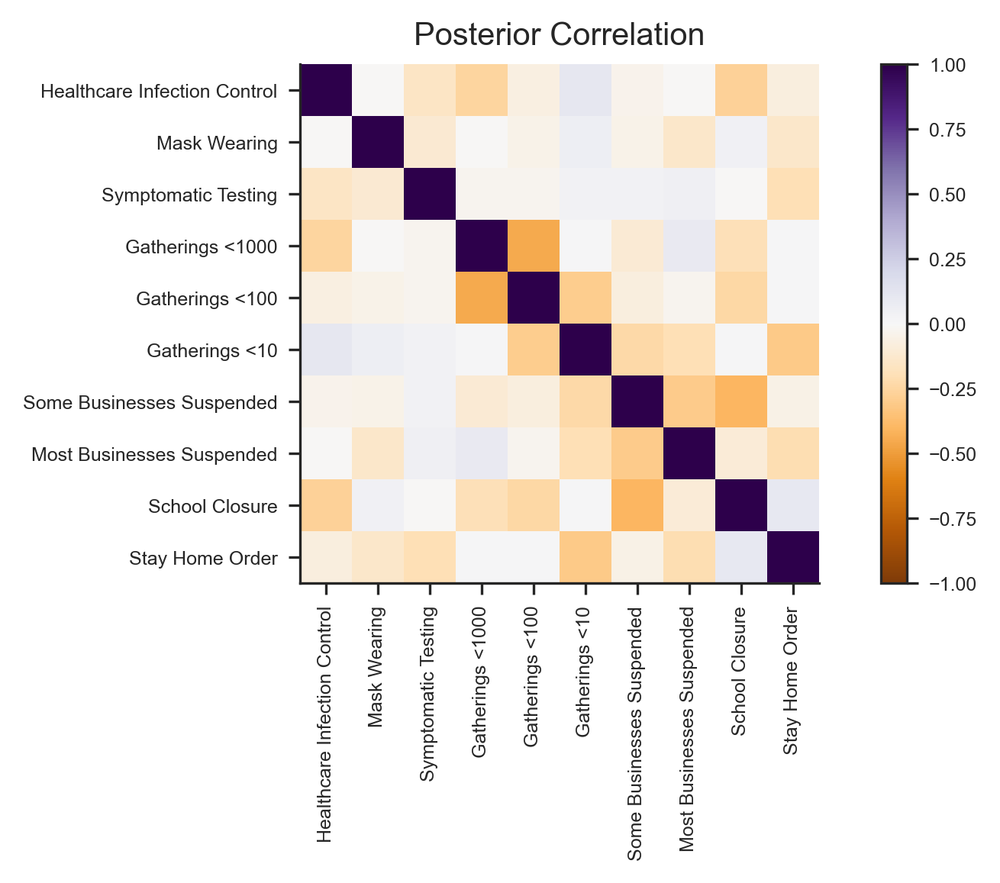

In [69]:
model3.plot_effect()

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effe

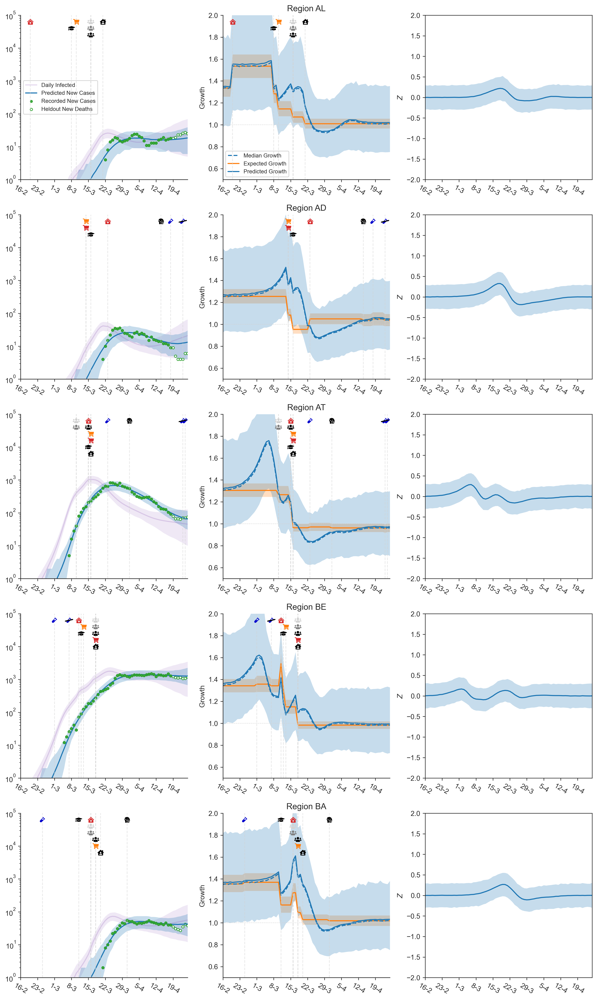

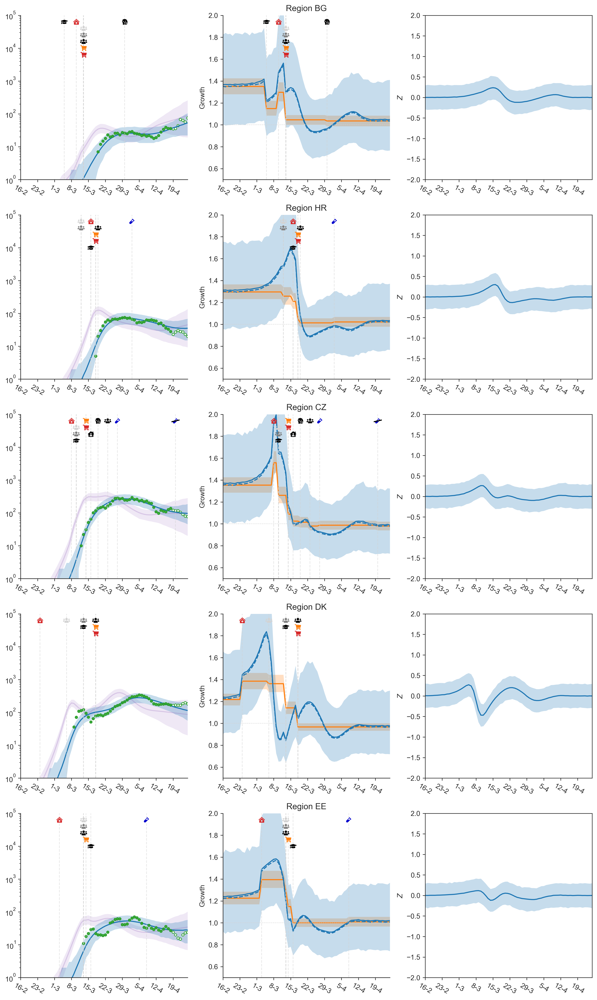

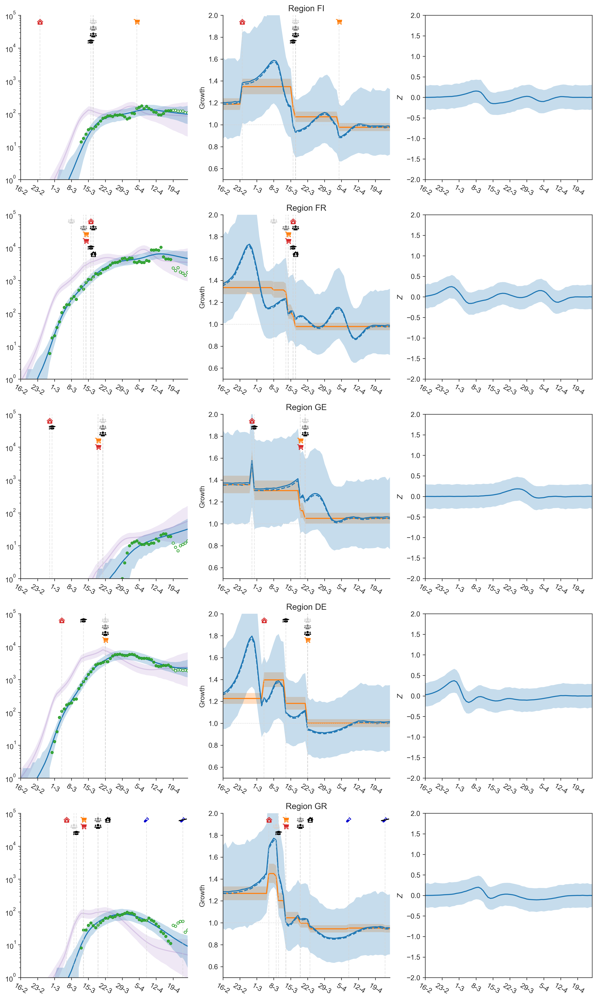

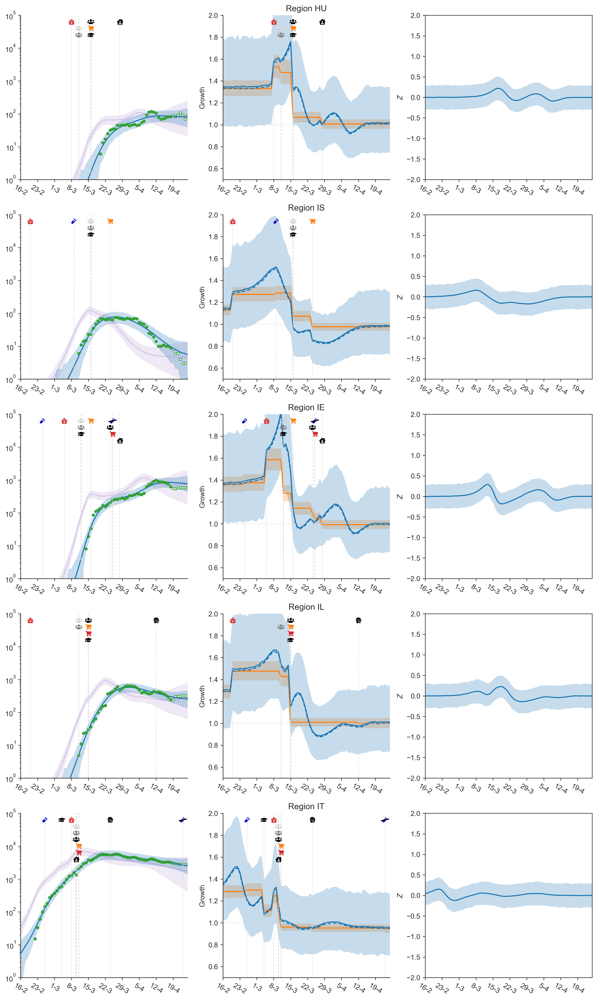

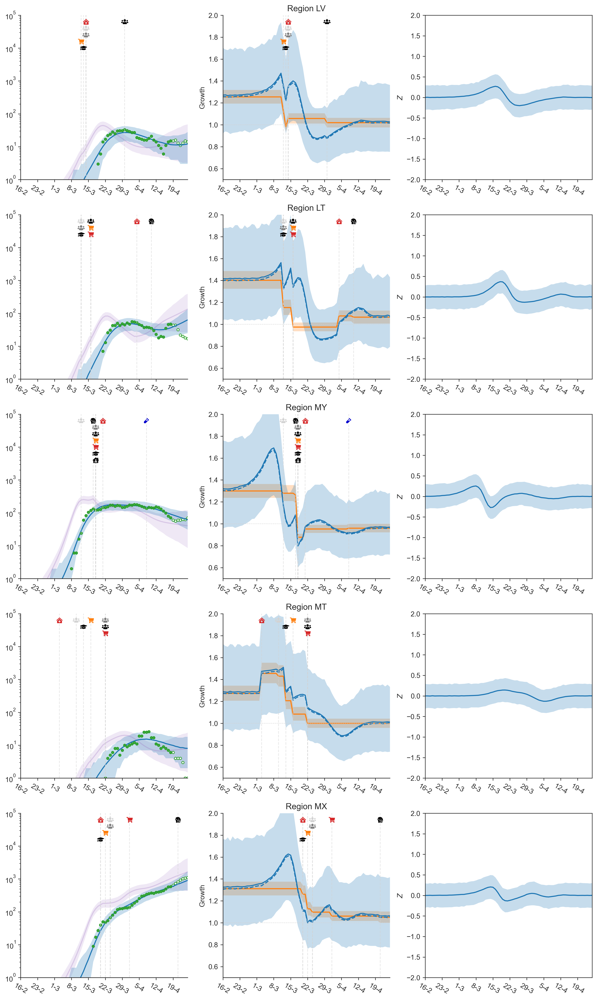

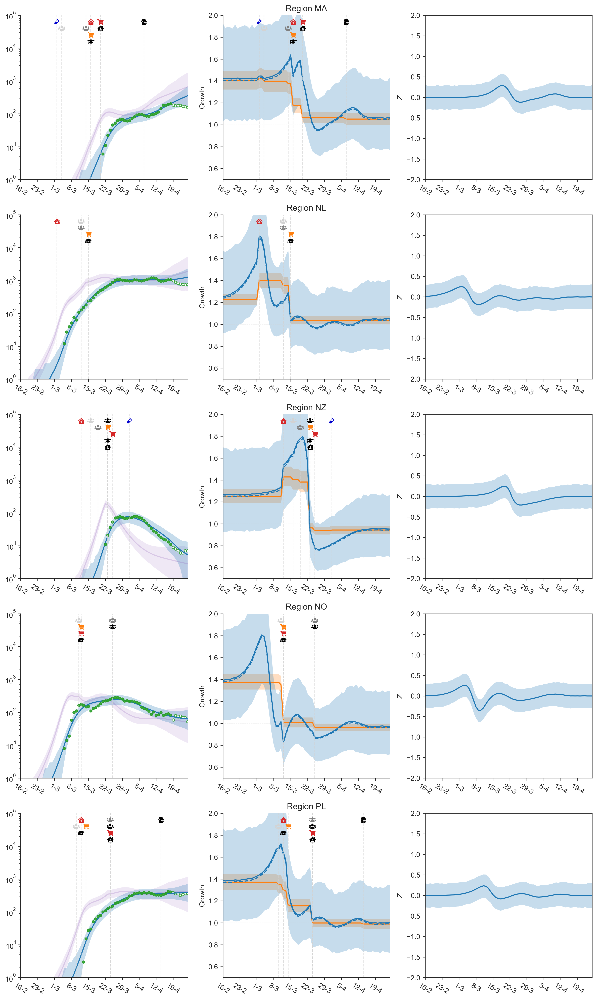

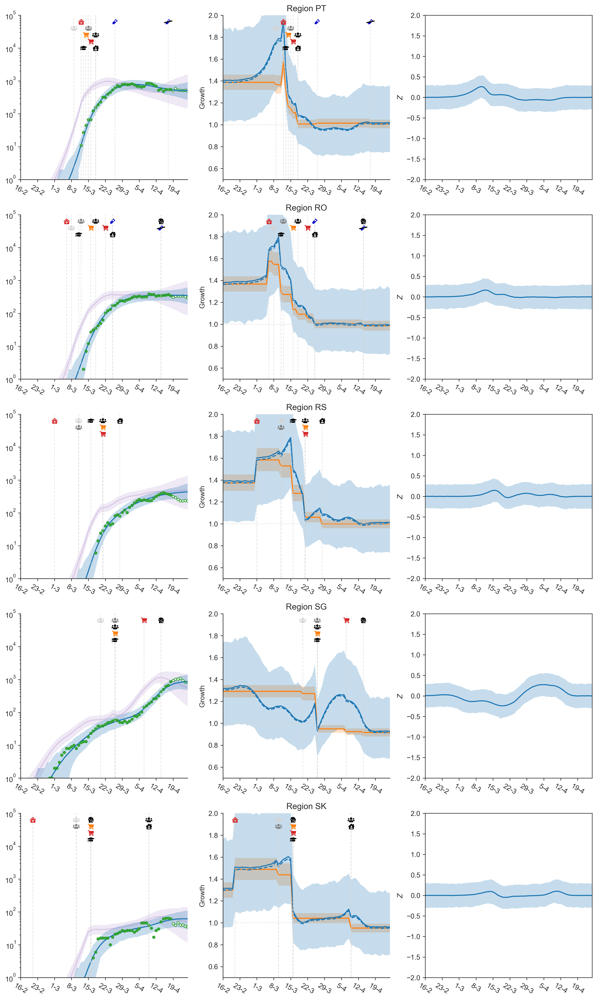

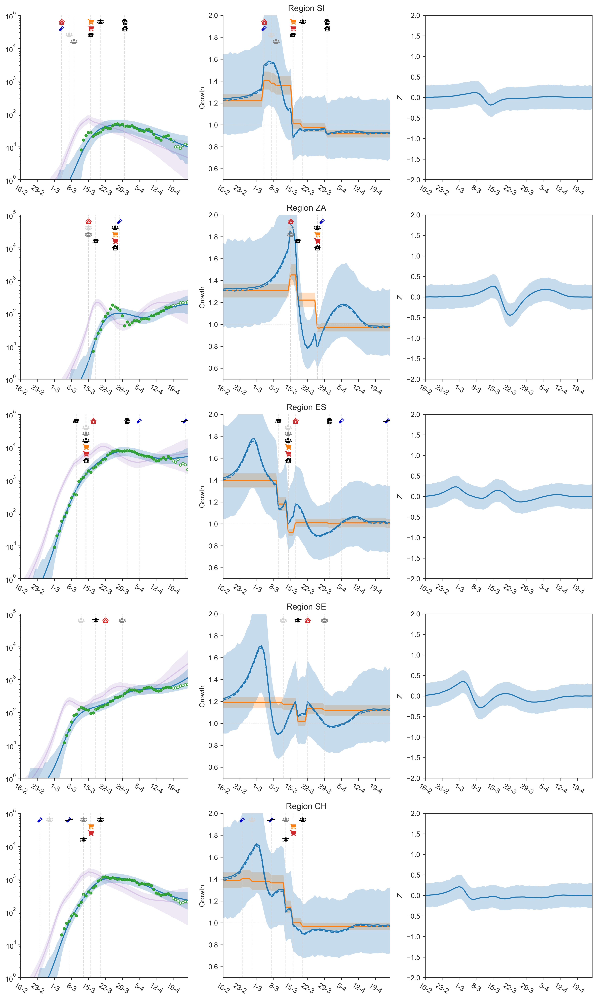

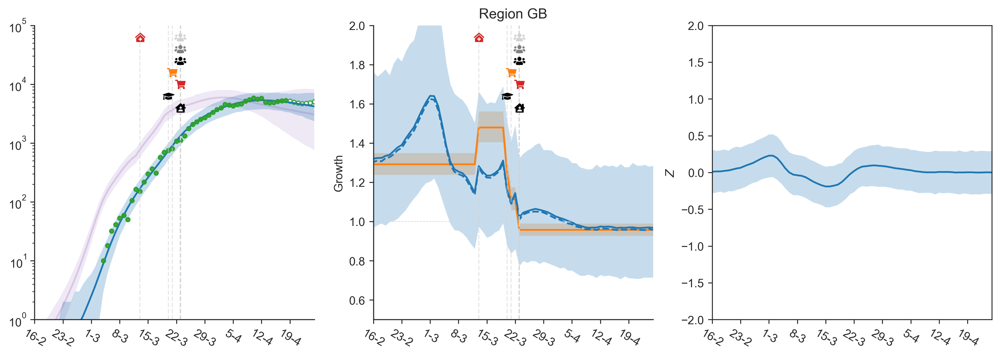

In [70]:
model3.plot_region_predictions(cm_plot_style)

In [71]:
model3.trace.varnames

['CM_Alpha',
 'RegionLogR',
 'Growth',
 'InitialSize_log',
 'Phi_log__',
 'CMReduction',
 'GrowthReduction',
 'ExpectedLogR',
 'ExpectedGrowth',
 'Z1',
 'Infected_log',
 'Infected',
 'ExpectedCases',
 'Phi']

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1cf164b10>,
      dtype=object)

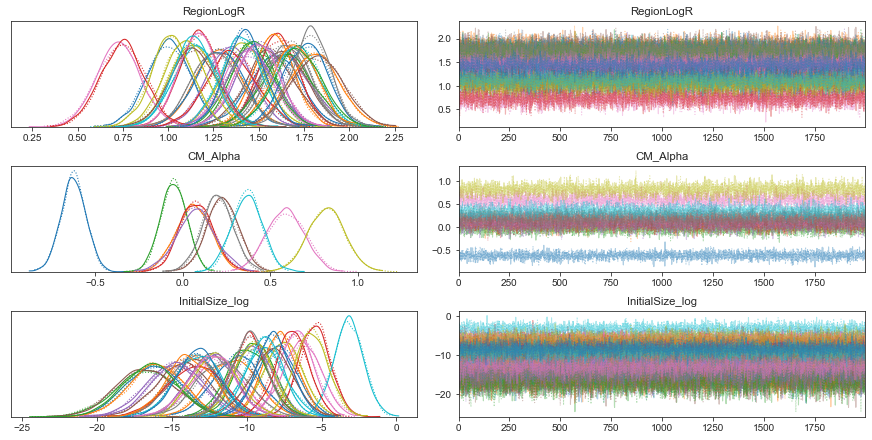

In [72]:
pm.traceplot(model3.trace, ["RegionLogR", "CM_Alpha", "InitialSize_log"])

In [76]:
data.Deaths[0, :].data

array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, 10., 10., 11., 15., 15., 16., 17., 20., 20., 21., 22., 22.,
       23., 23., 23., 23., 23., 24., 25., 26., 26., 26., 26., 26., 26.,
       27., 27., 27., 27.])

In [81]:
data.Confirmed[0, :].data

array([ nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan, 104., 123., 146., 174., 186.,
       197., 212., 223., 243., 259., 277., 304., 333., 361., 377., 383.,
       400., 409., 416., 433., 446., 467., 475., 494., 518., 539., 548.,
       562., 584., 609., 634., 663., 678., 712.])

In [84]:
data.Deaths[0, :].data

array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, 10., 10., 11., 15., 15., 16., 17., 20., 20., 21., 22., 22.,
       23., 23., 23., 23., 23., 24., 25., 26., 26., 26., 26., 26., 26.,
       27., 27., 27., 27.])

In [82]:
data.Active[0, :]

masked_array(data=[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
                   0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
                   0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
                   0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
                   0.0, 0.0, 0.0, 2.0, 10.0, 11.0, 22.0, 32.0, 37.0, 41.0,
                   50.0, 54.0, 57.0, 62.0, 68.0, 72.0, 85.0, 98.0, 108.0,
                   124.0, 151.0, 147.0, 156.0, 169.0, 168.0, 176.0, 177.0,
                   185.0, 198.0, 214.0, 237.0, 240.0, 230.0, 224.0, 221.0,
                   211.0, 213.0, 206.0, 212.0, 203.0, 218.0, 215.0, 230.0,
                   220.0, --, --, --, --, --, --, --],
             mask=[False, False, False, False, False, False, False, False,
                   False, False, False, False, False, False, False, False,
                   False, False, False, False, False, False, False, False,
                   False, False, False, False, Fal

In [79]:
data.NewDeaths[0, :].data

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       1., 4., 0., 1., 1., 3., 0., 1., 1., 0., 1., 0., 0., 0., 0., 1., 1.,
       1., 0., 0., 0., 0., 0., 1., 0., 0., 0.])

In [80]:
data.NewCases[0, :].data

array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  4.,  8., 14., 16., 19.,
       18., 15., 14., 15., 16., 18., 22., 24., 24., 21., 19., 15., 11.,
       11., 13., 13., 13., 16., 17., 19., 16., 17., 18., 18., 19., 23.,
       23., 26., 27., 25.])

In [109]:
with cm_effect.models.CMActive_Final_NB(data) as model3:
    model3.build_model()

Skipped day [(22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (1, 2), (2, 2), (3, 2), (4, 2), (5, 2), (6, 2), (7, 2), (8, 2), (9, 2), (10, 2), (11, 2), (12, 2), (13, 2), (14, 2), (15, 2), (16, 2), (17, 2), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (23, 2), (24, 2), (25, 2), (26, 2), (27, 2), (28, 2), (29, 2), (1, 3), (2, 3), (3, 3), (4, 3), (5, 3), (6, 3), (7, 3), (8, 3), (9, 3), (10, 3), (11, 3), (12, 3), (13, 3), (14, 3), (15, 3), (16, 3), (17, 3), (18, 3), (19, 3), (20, 3), (21, 3), (22, 3), (19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AL
Skipped day [(22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (1, 2), (2, 2), (3, 2), (4, 2), (5, 2), (6, 2), (7, 2), (8, 2), (9, 2), (10, 2), (11, 2), (12, 2), (13, 2), (14, 2), (15, 2), (16, 2), (17, 2), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (23, 2), (24, 2), (25, 2), (26, 2), (27, 2), (28, 2), (29, 2), (1, 3), (2, 3), (3, 3), (4, 3),

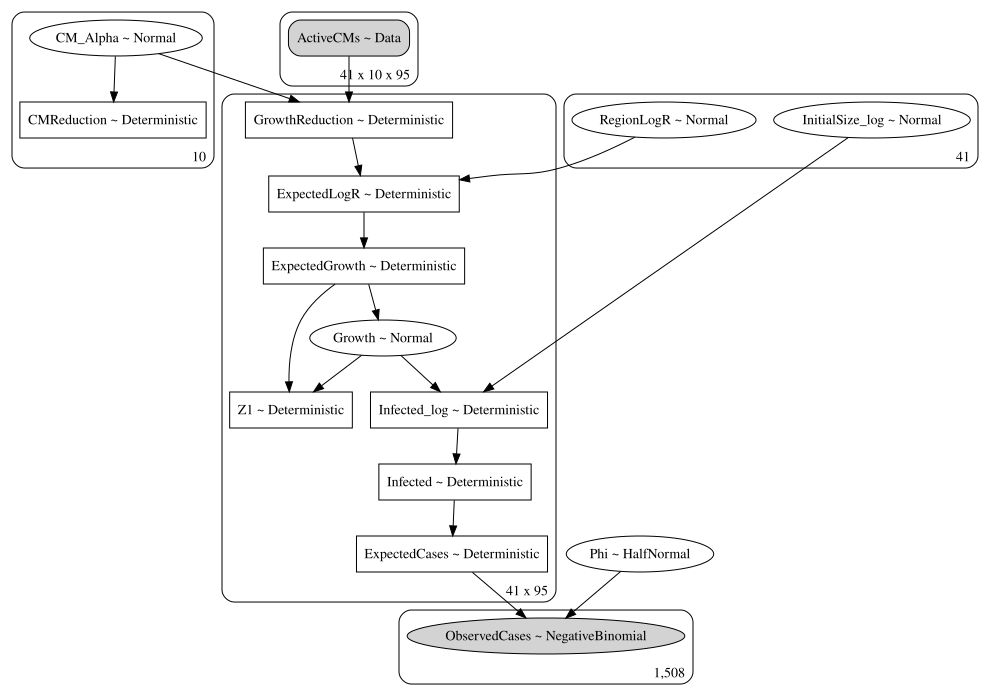

In [110]:
pm.model_to_graphviz(model3).render("model-active-final")
pm.model_to_graphviz(model3)

In [111]:
with model3.model:
    model3.trace = pm.sample(2000, chains=2)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
INFO:pymc3:NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [27:32<00:00,  3.03draws/s]


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out


<Figure size 2100x900 with 0 Axes>

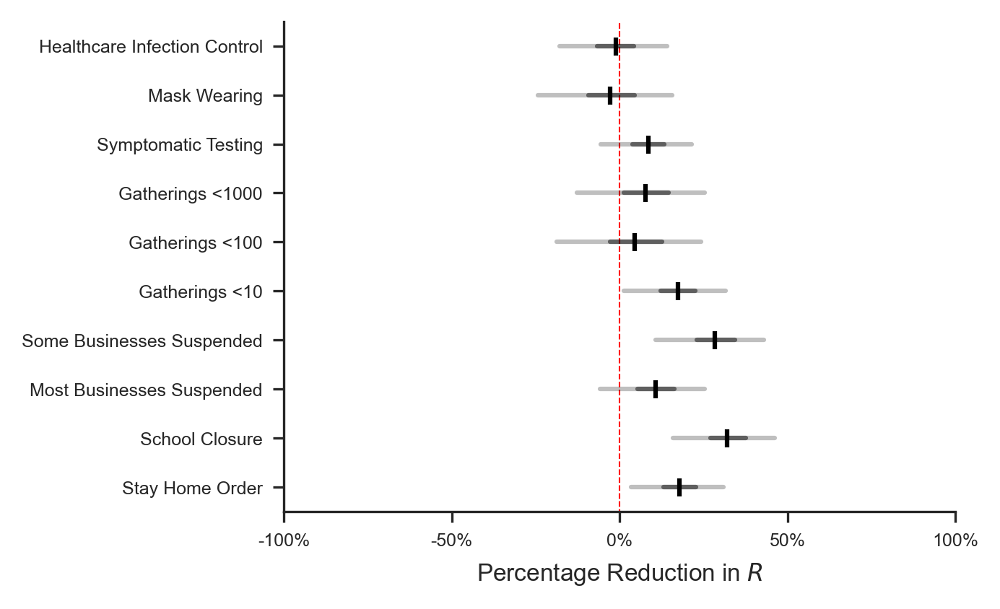

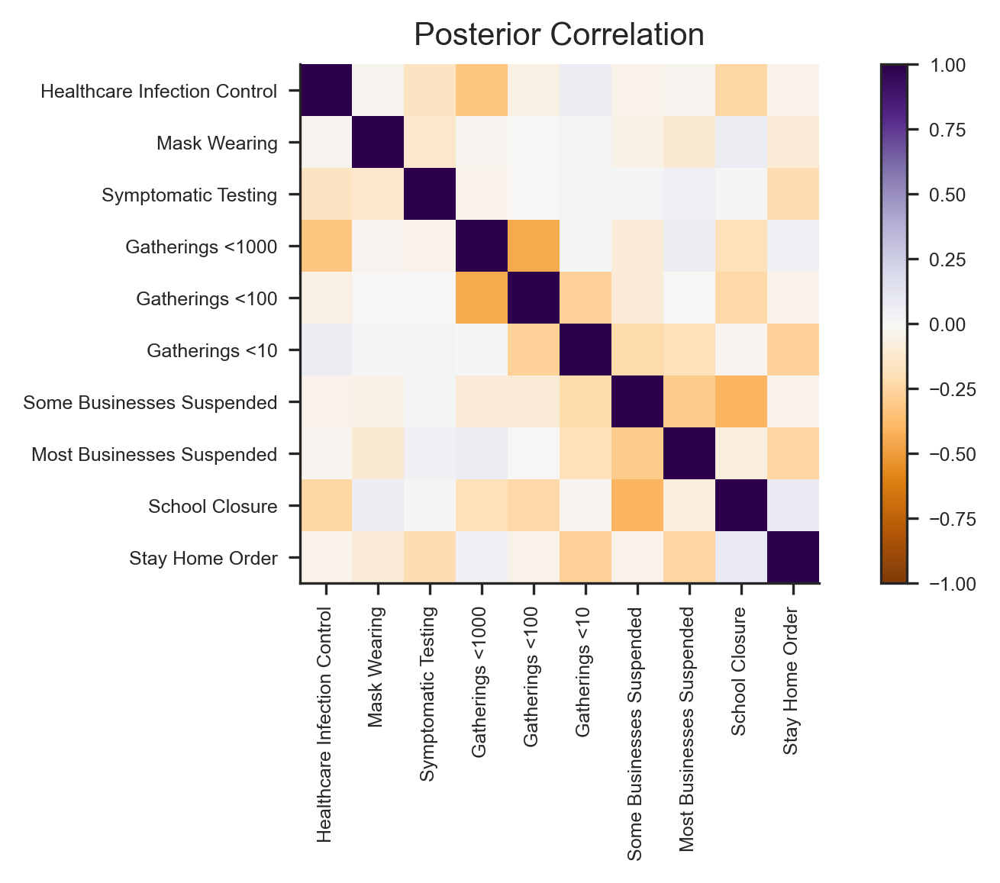

In [112]:
model3.plot_effect()

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effe

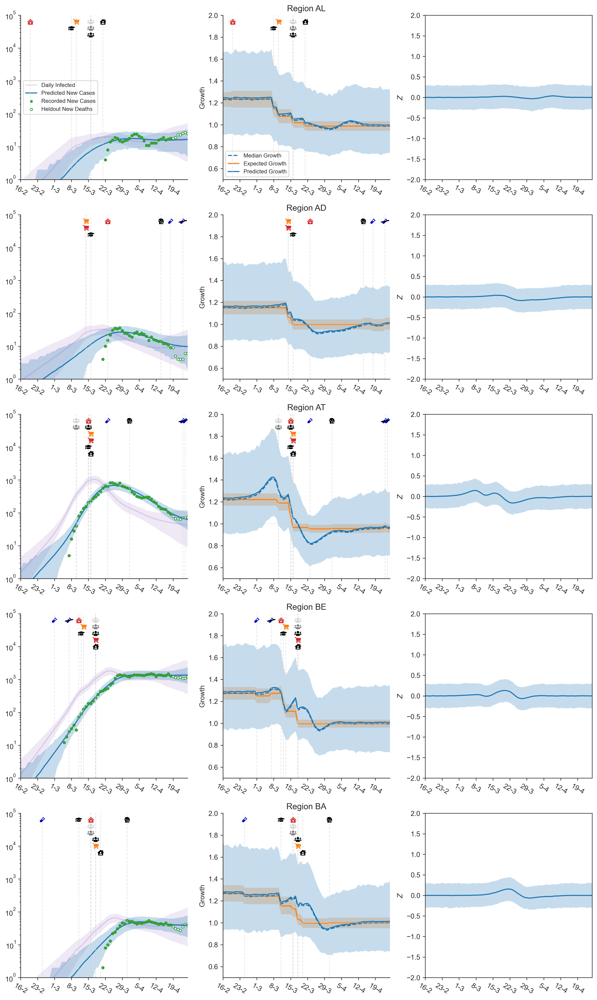

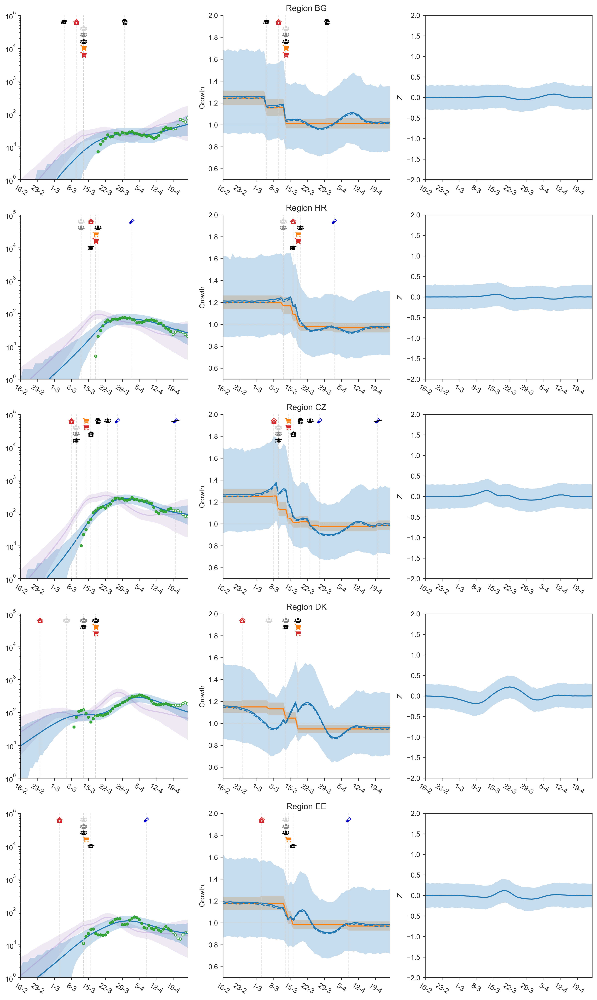

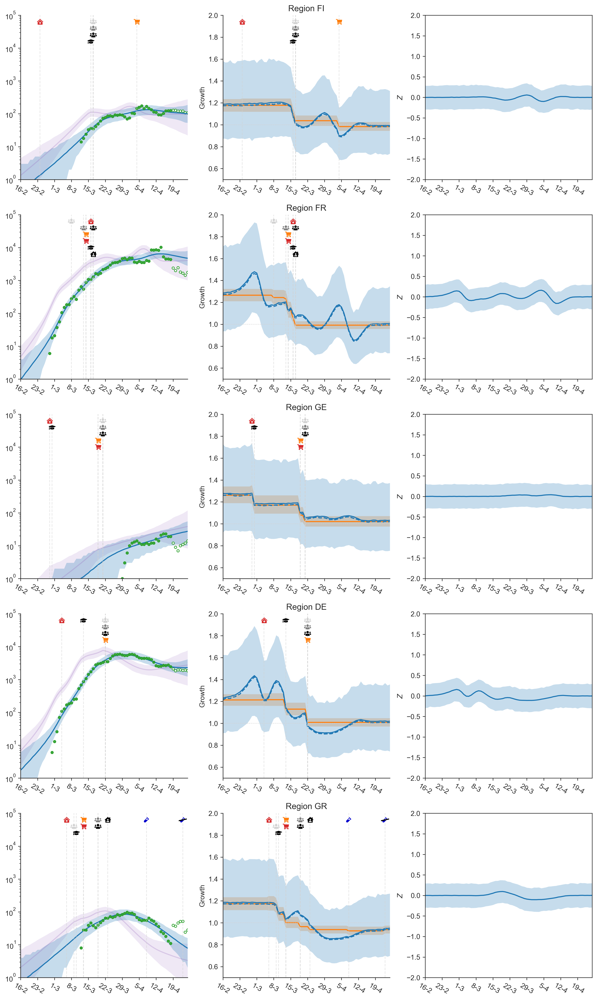

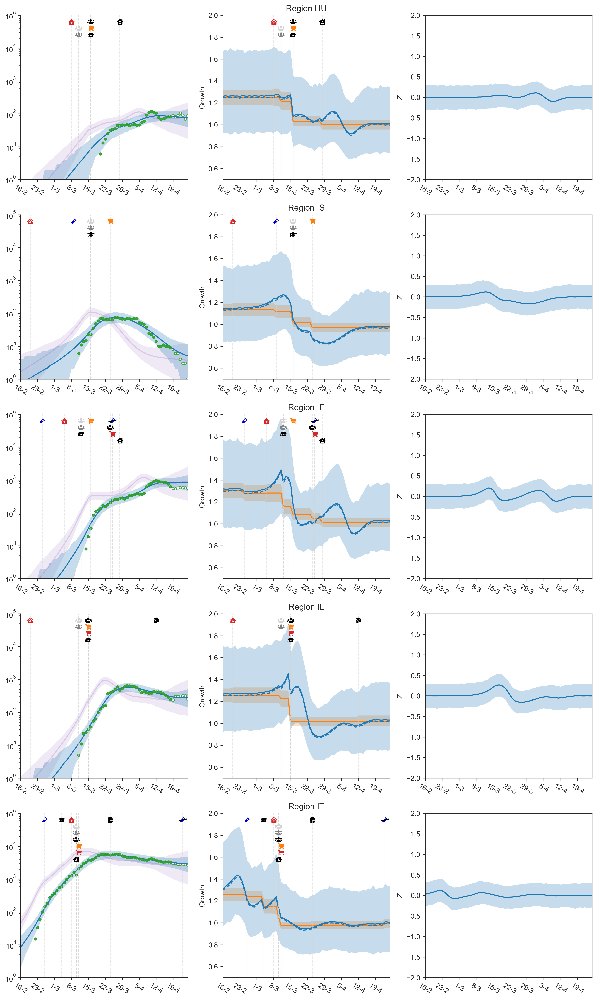

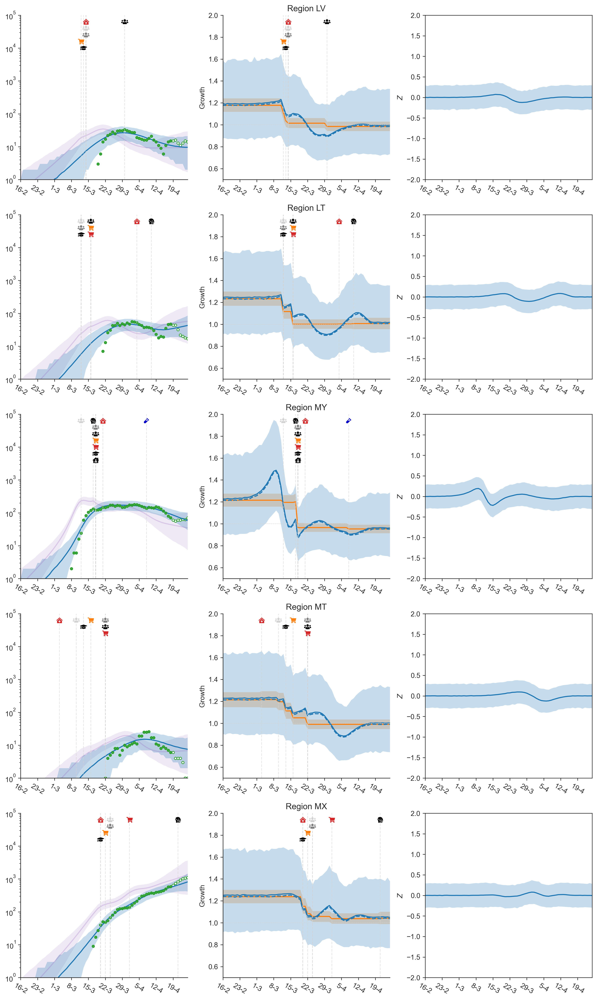

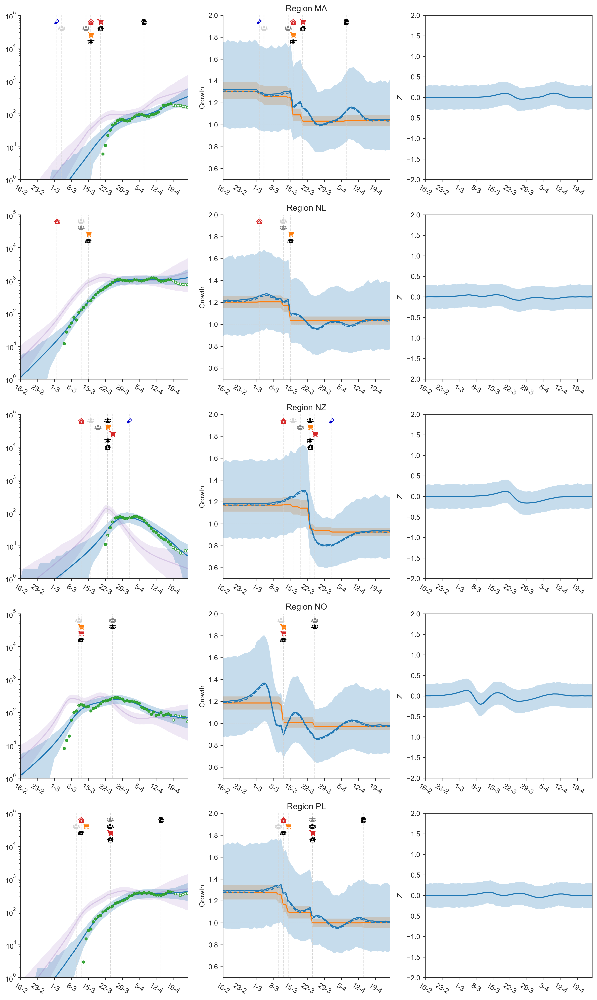

In [ ]:
model3.plot_region_predictions(cm_plot_style)

In [2]:
with cm_effect.models.CMActive_Final(data) as model4:
    model4.build_model()

NameError: name 'cm_effect' is not defined